In [13]:
import cv2
import os
import numpy as np
import tensorflow as tf
import keras
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.models import load_model
from PIL import Image
import numpy as np
from skimage import transform
import imageio
import matplotlib.pyplot as plt

from retinaface import RetinaFace

In [14]:
from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale = 1./255)

test_datagen = ImageDataGenerator(rescale = 1./255)

In [15]:
input_size = (160, 160)
batch_size = 64

In [16]:
training_set = train_datagen.flow_from_directory('Data/Custom/Split/augmented_train',
                                                 target_size = input_size,
                                                 batch_size = batch_size,
                                                 class_mode = 'categorical')

test_set = test_datagen.flow_from_directory('Data/Custom/Split/validation',
                                            target_size = input_size,
                                            batch_size = batch_size,
                                            class_mode = 'categorical')

Found 1535 images belonging to 14 classes.
Found 145 images belonging to 14 classes.


In [17]:
label_map = (training_set.class_indices)

In [18]:
label_map["Unknown"] = 14
label_map

{'Aishu': 0,
 'Aswini': 1,
 'Kick': 2,
 'Nandana': 3,
 'Raji': 4,
 'Santhosh': 5,
 'Sathish': 6,
 'Sruthi': 7,
 'Suma': 8,
 'Surudhi': 9,
 'Swathi': 10,
 'Varma': 11,
 'Venky': 12,
 'Yoga': 13,
 'Unknown': 14}

In [19]:
key_list = list(label_map.keys())
val_list = list(label_map.values())

In [20]:
model = load_model("facenet_2.h5")

In [30]:
def predict(face):
    np_image = np.array(face).astype('float32')/255
    np_image = transform.resize(np_image, (160, 160, 3))
    np_image = np.expand_dims(np_image, axis=0)
    pred = model.predict(np_image)
    cls = pred.argmax(axis=-1)
    if pred[0][cls]:
        position = val_list.index(cls)
    else:
        position = val_list.index(14)
    print(max(pred[0]))
    
    #print(key_list[position])
    return key_list[position]
    

In [31]:
def detect(frame, gray):
    obj = RetinaFace.detect_faces(frame)
    print(len(obj.keys()))
    for key in obj.keys():
        ide = obj[key]
        facial_area = ide["facial_area"]
        x, y, w, h = facial_area[0], facial_area[1], facial_area[2], facial_area[3]
        cv2.rectangle(frame, (w, h), (x, y), (255, 0, 0), 5)
        face = frame[y: h, x: w]
        text = predict(face)
        cv2.putText(frame, text, (x,y), cv2.FONT_HERSHEY_PLAIN, 2, (0, 255, 0), 5)
    
    plt.figure(figsize = (20,20))
    plt.imshow(frame[:, :, ::-1])
           
           

In [32]:
def load_images_from_folder(folder):
    count = 0
    for f in os.listdir(folder):
        if (f.endswith(".jpg") or f.endswith(".png") or f.endswith(".JPG") or f.endswith(".jpeg") or f.endswith(".HEIC") or f.endswith(".heic")):
            img = cv2.imread(os.path.join(folder,f))          
            print(f)
            if img is not None:
                count += 1
                gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
                detect(img, gray)


Test_image_006.HEIC
Test_image_0041.jpeg
3
0.015858233
0.009567171
0.07927737
Test_image_0040.jpeg
3
0.03863372
0.0064980984
0.0061377585
Test_image_002.JPG
7
0.08337045
0.011621773
0.06047958
0.03523791
0.44759756
0.00604102
0.03282231
Test_image_003.JPG
3
0.07013458
0.00989116
0.10932791
Test_image_0026.jpg
5
0.5304237
0.05682221
0.8774282
0.17155784
0.009777099
Test_image_0019.JPG
8
0.41700798
0.012949705
0.22928372
0.28294057
1.0
0.22332215
0.58576834
0.08211613
Test_image_0024.jpg
9
0.9677275
0.9149864
0.9255427
0.8967998
0.79447526
0.6292584
0.019359738
0.0049270093
0.042353153
Test_image_0020.JPG
7
0.15852156
0.395
0.06992352
0.17551383
0.00823763
0.003551513
0.033711553
Test_image_0027.jpeg
4
0.27946702
0.0014046431
0.060124427
0.27937979
Test_image_0031.jpeg
5
0.76920366
0.0089199245
0.5634396
0.8059889
0.15279776
Test_image_0038.heic
Test_image_0021.JPG
9
0.6093486
0.116817206
0.036088437
0.011067182
0.0027630925
0.034933746
0.03824389
0.11095041
0.005545169
Test_image_0023.j

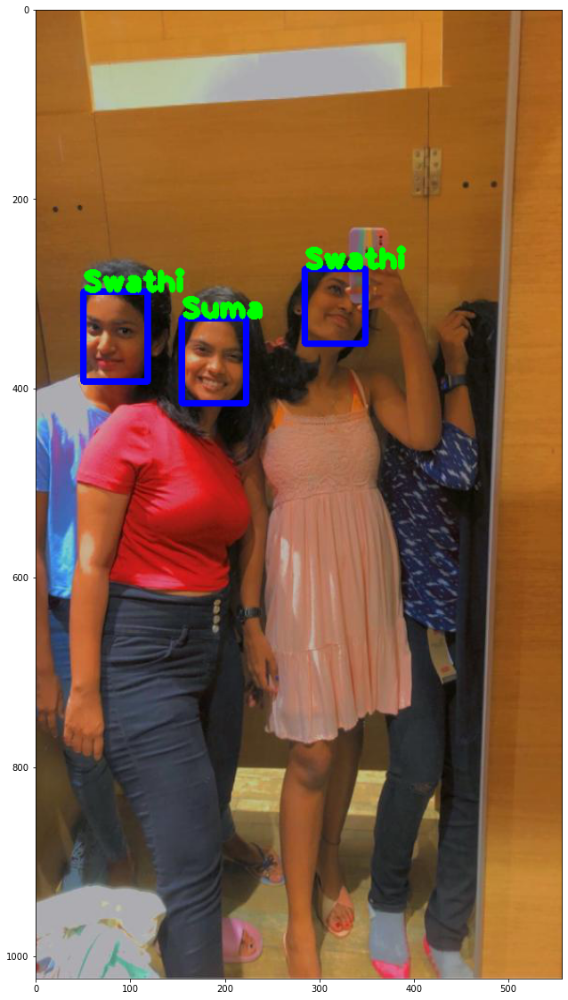

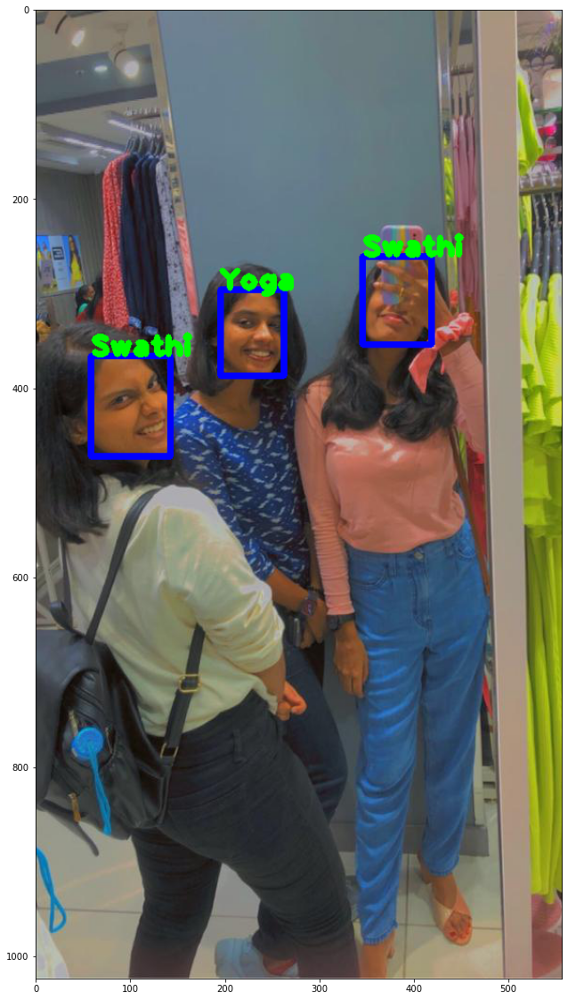

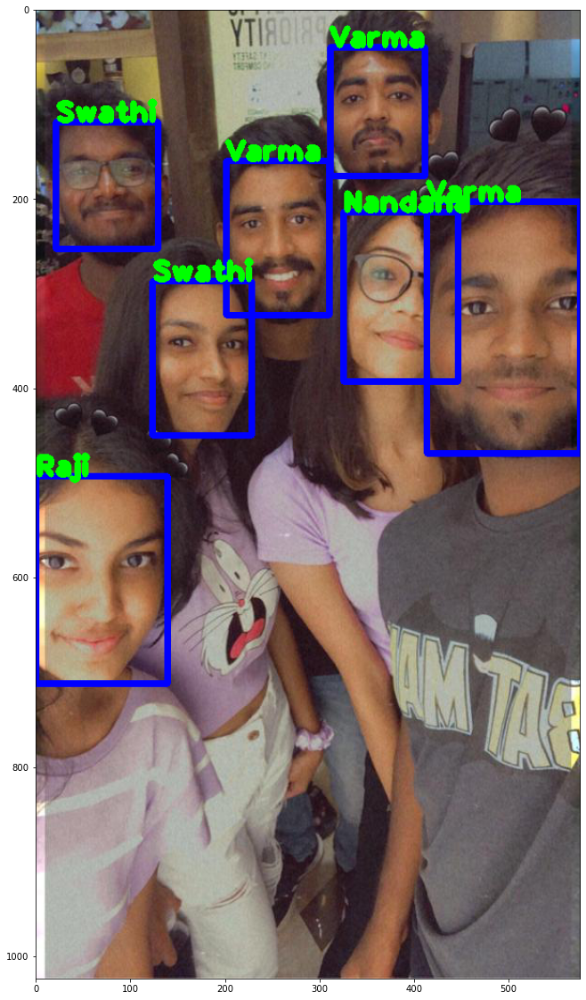

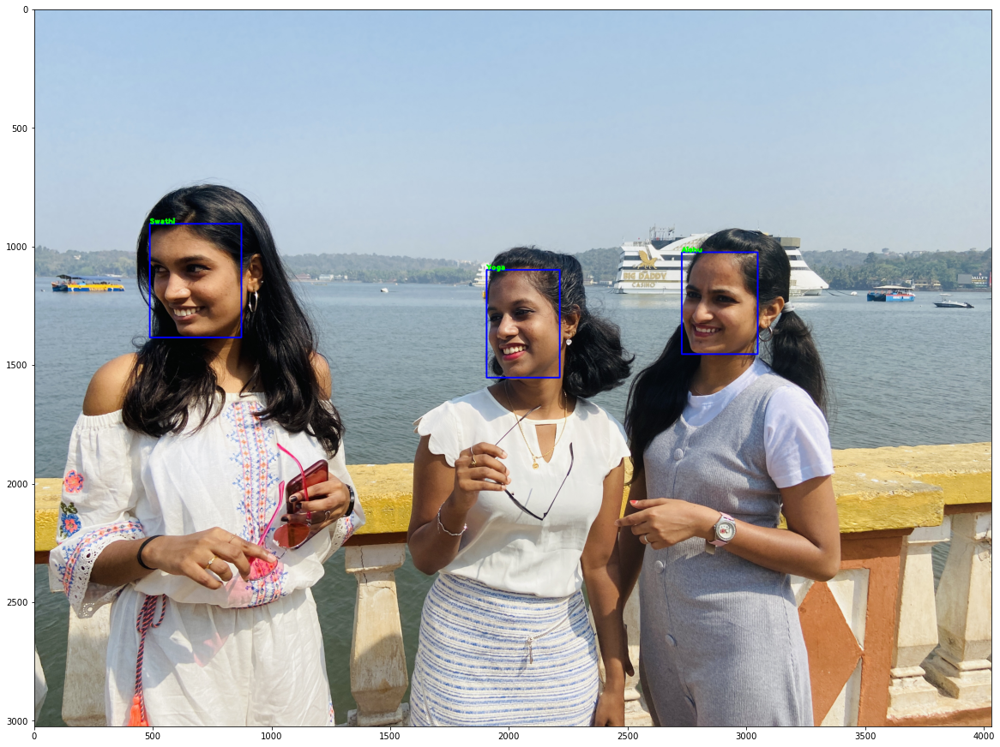

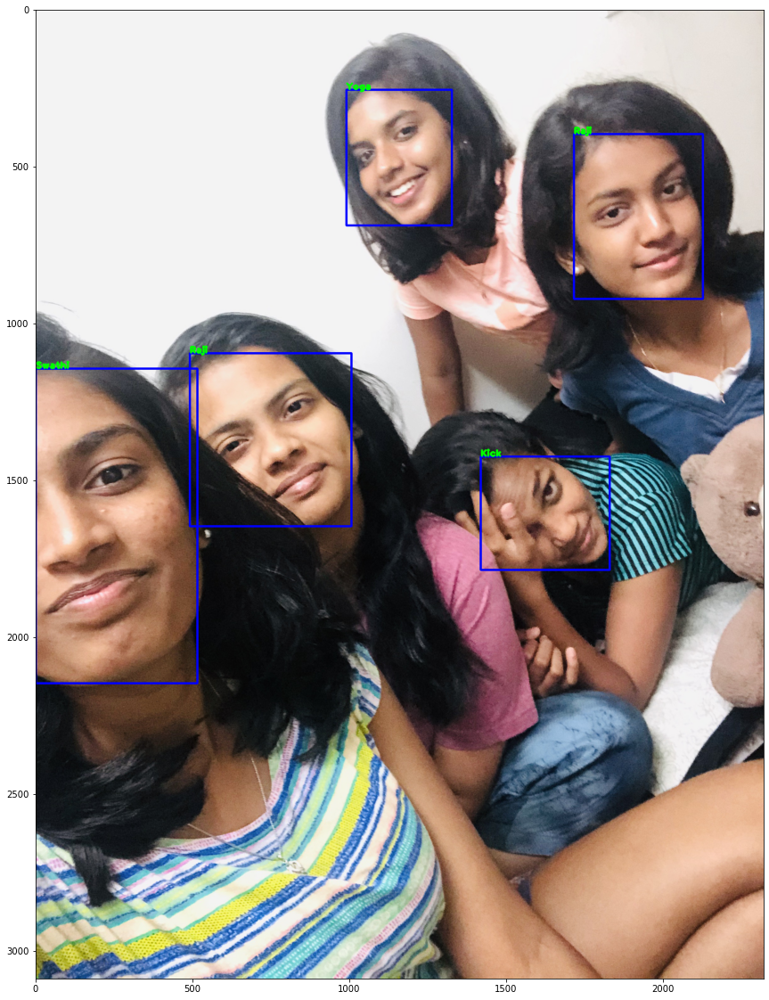

...

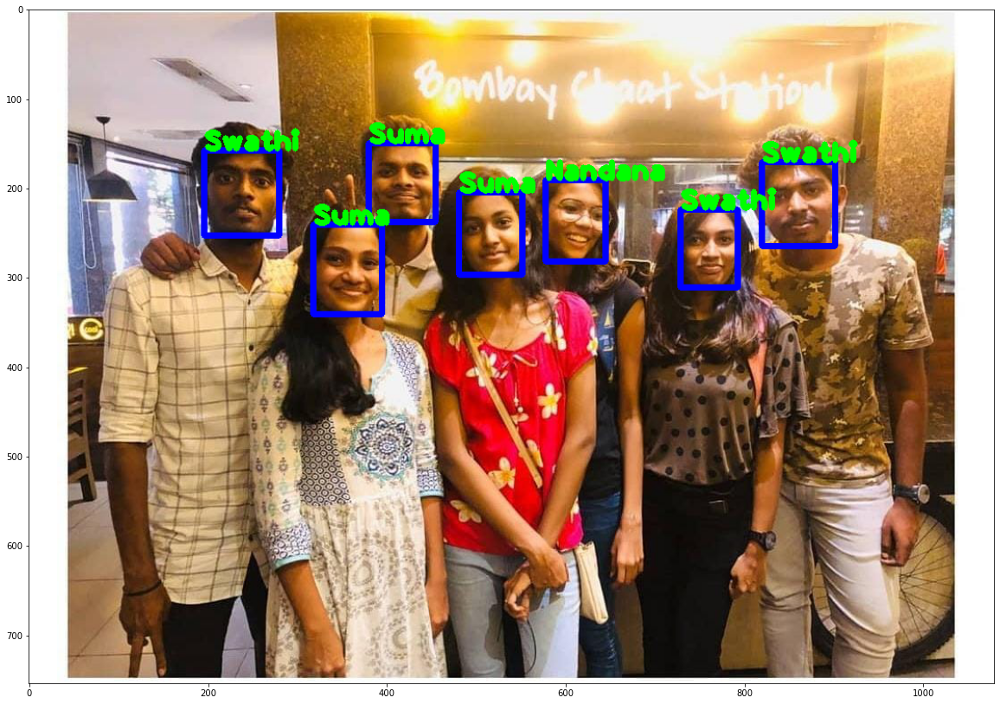

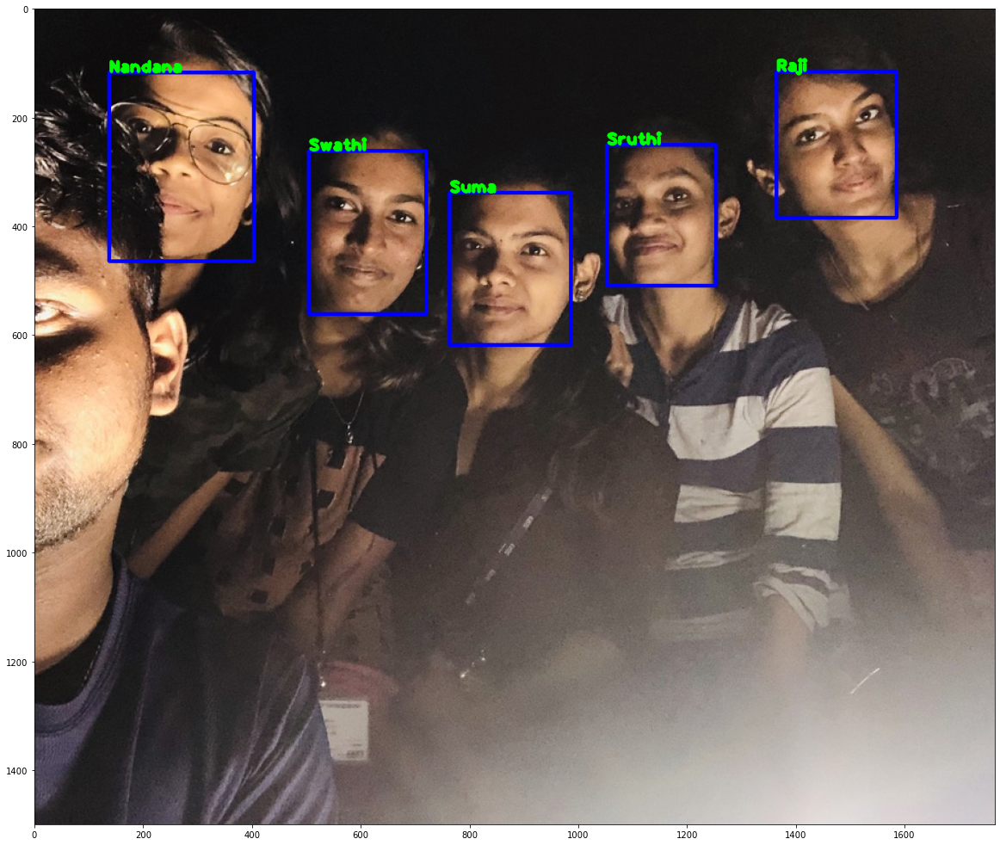

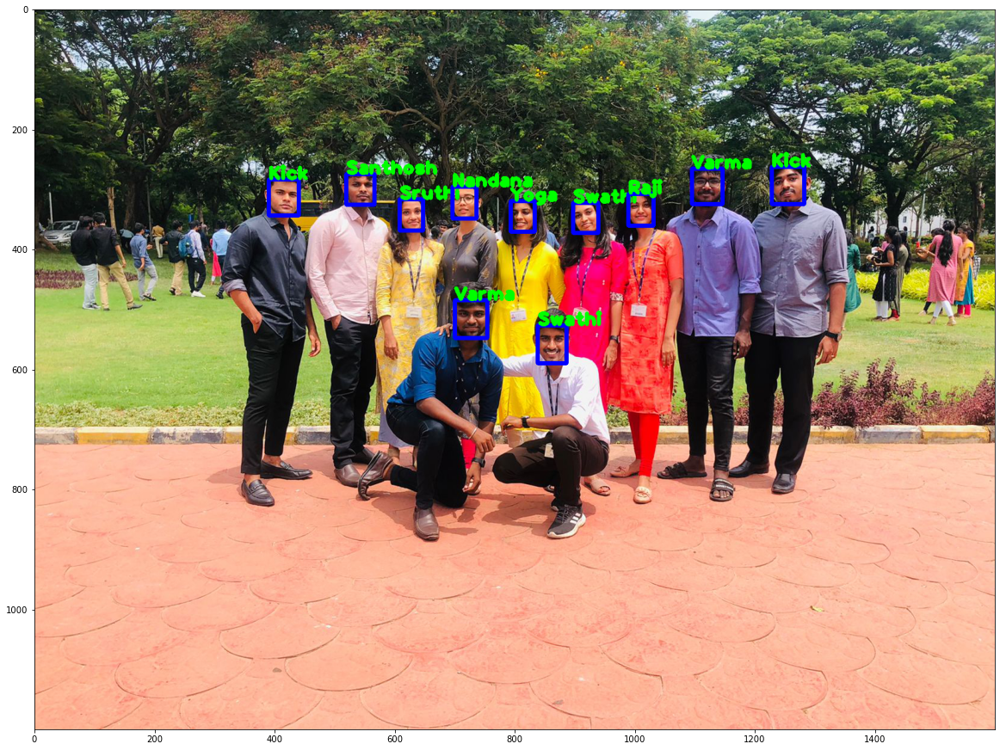

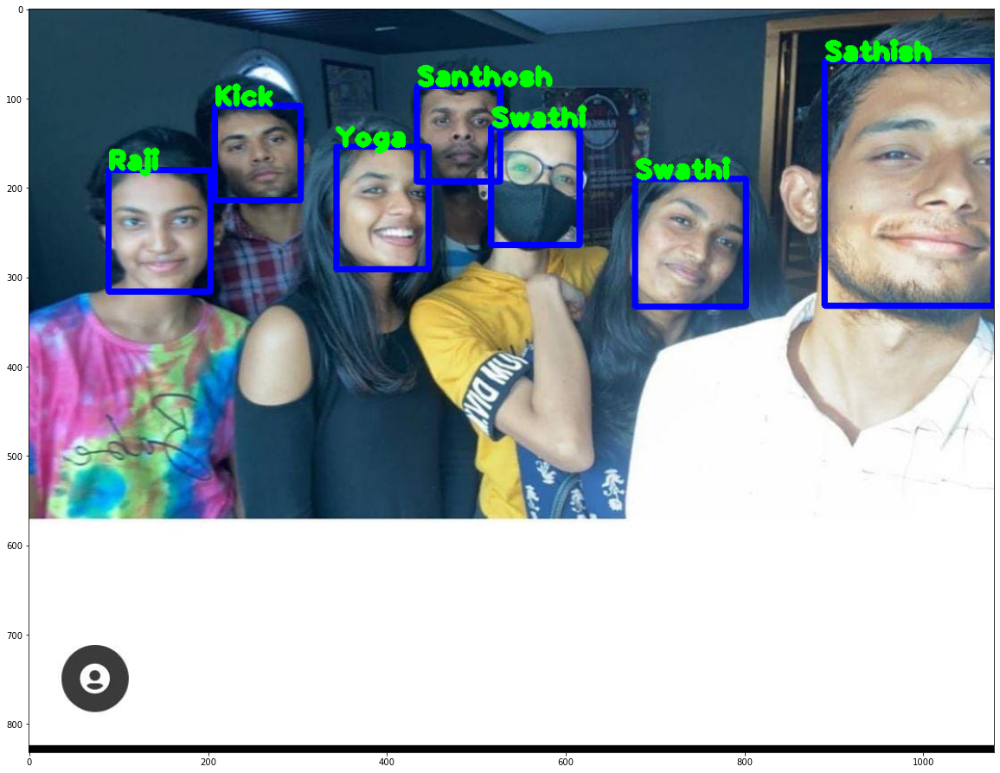

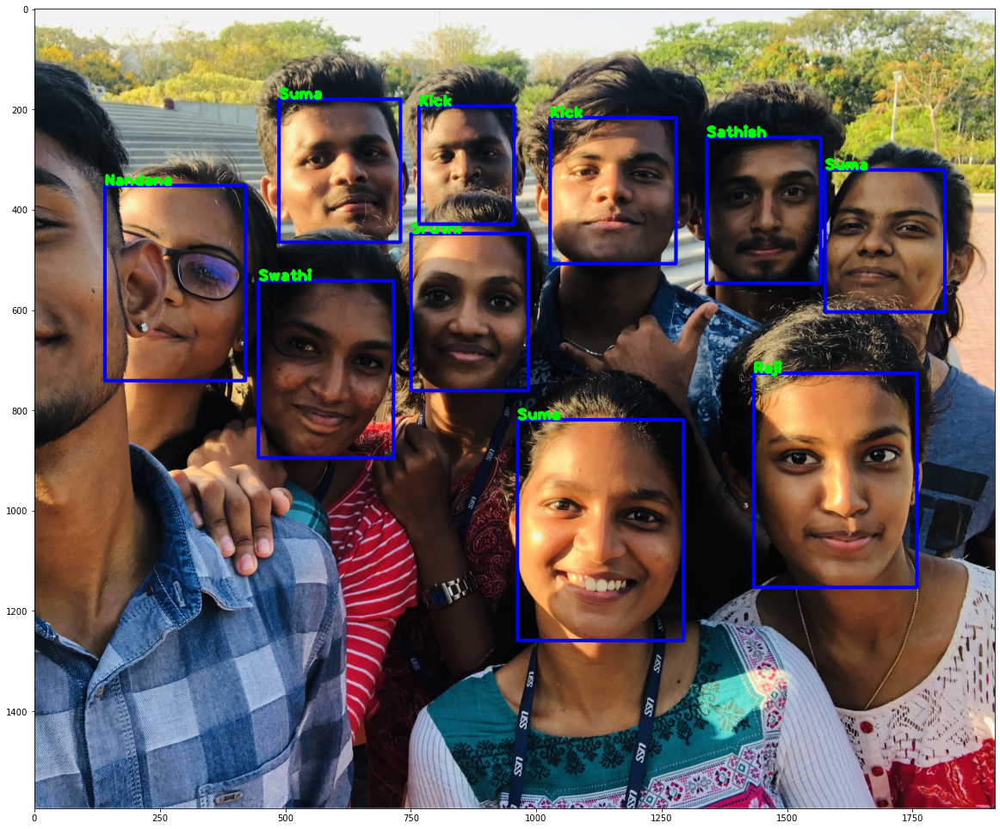

In [33]:
load_images_from_folder('Data/Custom/Split/Ph')